In [81]:
%load_ext autoreload
%autoreload 2

# load dependencies
import pandas as pd
import geopandas as gpd
import numpy as np
import seaborn as sns
import scipy.stats as stats
from datetime import datetime
import pysal 
import libpysal #added
pd.options.mode.chained_assignment = None 
from geofeather import to_geofeather, from_geofeather
from matplotlib import pyplot as plt
from pysal.explore import esda
import numpy as np
from pyproj import CRS
import folium
from pyproj import Transformer
#import skmob

from envirocar import TrackAPI, DownloadClient, BboxSelector, ECConfig

# create an initial but optional config and an api client
config = ECConfig()
track_api = TrackAPI(api_client=DownloadClient(config=config))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Functions

In [2]:
inputCRS = CRS.from_epsg(4326)
outputCRS = CRS.from_epsg(25832)
transformer = Transformer.from_crs(inputCRS, outputCRS)
def project(a,b):
    return transformer.transform(a, b)

In [3]:
def getisOrd(data, value = 'value', threshold = 50, lat = 'lat', lng = 'lng'):
    coords = [project(row[lat], row[lng]) for index, row in data.iterrows()]
    w = libpysal.weights.DistanceBand(coords, threshold)         #w = pysal.weights.DistanceBand(coords, threshold)
    #getisOrdGlobal = esda.getisord.G(data_speed['time_sec'], w)
    getisOrdLocal = esda.getisord.G_Local(data[value], w, transform='B')
    getisOrdLocal.Zs

    data['z_score'] = getisOrdLocal.Zs
    data['p_value'] = getisOrdLocal.p_norm

    return data

In [4]:
def pltcolor(p_value, z_score, confidence):
    cols=[]
    size=[]
    for p, z in zip(p_value, z_score):
        if p < confidence:
            if z > 0:
                cols.append('red')        #hotspot color
                size.append(20)
            else:
                cols.append('blue')       #coldspot color
                size.append(20)
        else:
            cols.append('grey')           #others
            size.append(10)
    return cols , size

In [5]:
def plot(data, lat = 'lat', lng = 'lng', p_field = 'p_value', z_field = 'z_score'):
    from matplotlib import pyplot as plt
    #z_score>1.96 hot spots (95% ci)
    #z_score<-1.96 cold spots
    from matplotlib import colors as cls

    f, axarr = plt.subplots(1, figsize=(10,10))
    total_range = cls.Normalize(vmin = - 1.96, vmax = 1.96)
    
    cols, sizes = pltcolor(data[p_field], data[z_field], 0.05)

    plt.scatter(x=data['lng'], y=data['lat'], s=sizes, c=cols, lw = 0) #Pass on the list created by the function here
    plt.grid(True)
    plt.show()

In [6]:
def makepopup(t):
        return str(t)

In [82]:
def map(m, data, value = 'value', style = 'hotspots', lat = 'lat', lng = 'lng', p_field = 'p_value', z_field = 'z_score', col ='#f09205'):

    lats = data[lat]
    lngs = data[lng]

    avg_lat = sum(lats) / len(lats)
    avg_lngs = sum(lngs) / len(lngs)

    latlngs = []
    if style == 'hotspots':
        #z-value
        z = data[z_field]
        p = data[p_field]
        color, sizes = pltcolor(p, z, 0.05)
        value = data[value]
        for lat,lng,c,v in zip(lats, lngs, color, value):
            folium.CircleMarker([lat,lng], color = c, radius =3, fill = c, popup = makepopup(v)).add_to(m)
            latlngs.append([lat,lng])
    else:
        color = [col]*len(data)
        for lat,lng,c in zip(lats, lngs, color):
            folium.CircleMarker([lat,lng], color = c, radius =3, fill = c).add_to(m)
            latlngs.append([lat,lng])

    m.fit_bounds(latlngs)

In [83]:
def add_polygon(m, polygon,fillColor):
    folium.GeoJson(
        polygon,
        style_function= lambda feature:{
            'fillColor': fillColor,
            'color' : '#f7f7f7',
            'weight' : 1,
            'fillOpacity' : 0.7,
        }
    ).add_to(m)

# Data Import
EnviroCar tracks data is imported and saved in geofeather format, which is a faster for geometries with geopandas. Tracks are also clipped by the initial bounding box to cut out the tracks extending beyond the extent of bounding box.

In [ ]:
## Mönchengladbach bbox coordinates
bbox = BboxSelector([
    6.3301849365234375, # min_x
    51.13369295212583, # min_y
    6.540985107421875, # max_x
    51.23870648334856  # max_y
])
# issue a query
track_df = track_api.get_tracks(bbox=bbox, num_results=500) # requesting 500 tracks inside the bbox
track_df.head()

In [ ]:
#bounding box polygon in geodataframe
from shapely.geometry import Polygon
bboxpoly = Polygon([(6.3301849365234375, 51.13369295212583,), 
                                       (6.540985107421875,51.13369295212583), 
                                       (6.540985107421875, 51.23870648334856 ), 
                                       (6.3301849365234375,51.23870648334856)])
bboxpoly_gdf = gpd.GeoDataFrame([1],geometry=[bboxpoly])

In [ ]:
#plotting the tracks and bounding box shows the extending tracks
base = bboxpoly_gdf.plot(color='white', edgecolor='red')
track_df.plot(ax=base)

In [ ]:
#clipping track_df by bboxpoly_gdf
track_df_copy = track_df.reset_index(drop = True)
clipTracks_df = gpd.clip(track_df_copy, bboxpoly_gdf)

In [ ]:
clipTracks_df.plot()

In [ ]:
#conversion to feather format
data_path = 'Data/Monchengladbach_500.feather'
clipTracks_df.reset_index(inplace = True)
to_geofeather(clipTracks_df, data_path)

In [8]:
#checking data
track_df_500 = from_geofeather('Data/Monchengladbach_500.feather')
track_df_500.columns

Index(['level_0', 'index', 'id', 'time', 'geometry', 'GPS Bearing.value',
       'GPS Bearing.unit', 'Intake Temperature.value',
       'Intake Temperature.unit', 'MAF.value', 'MAF.unit',
       'Intake Pressure.value', 'Intake Pressure.unit', 'Engine Load.value',
       'Engine Load.unit', 'GPS Accuracy.value', 'GPS Accuracy.unit',
       'GPS Altitude.value', 'GPS Altitude.unit', 'Rpm.value', 'Rpm.unit',
       'GPS Speed.value', 'GPS Speed.unit', 'GPS VDOP.value', 'GPS VDOP.unit',
       'GPS PDOP.value', 'GPS PDOP.unit', 'Speed.value', 'Speed.unit',
       'GPS HDOP.value', 'GPS HDOP.unit', 'track.id', 'track.length',
       'track.begin', 'track.end', 'sensor.type', 'sensor.engineDisplacement',
       'sensor.model', 'sensor.id', 'sensor.fuelType',
       'sensor.constructionYear', 'sensor.manufacturer',
       'Calculated MAF.value', 'Calculated MAF.unit', 'CO2.value', 'CO2.unit',
       'Consumption.value', 'Consumption.unit', 'Throttle Position.value',
       'Throttle Position

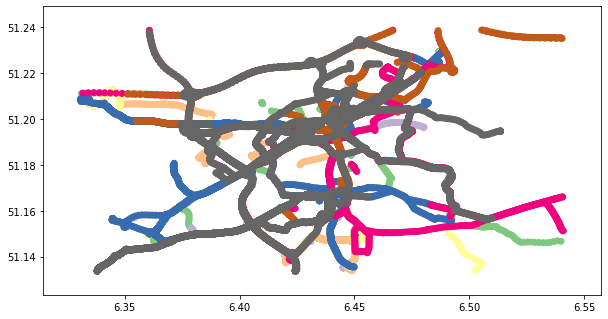

In [9]:
track_df_500.plot(figsize=(10, 12), c=track_df_500['id'], cmap = 'Accent')
#color based on track id

### Hotspots For Vehicle Speed


count    20569.000000
mean         3.667509
std          1.047842
min          0.000000
25%          3.000000
50%          3.000000
75%          5.000000
max         15.000000
Name: time_diff, dtype: float64

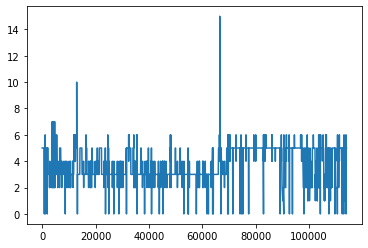

In [10]:
## select stopping times data
df_speed = track_df_500

# convert the date column to datetime type
df_speed['time_datetime'] = pd.to_datetime(df_speed['time'], format = "%Y-%m-%dT%H:%M:%S")
.fillna(pd.Timedelta('0 days'))
df_speed['time_diff'] = df_speed['time_diff'].apply(lambda x: x.total_seconds())

##identify first record in each track and adding a default value of 0
tracks_id = (df_speed['id'].groupby(df_speed['track.id']).nth(0)).tolist()
df_speed['time_diff'][df_speed['id'].isin(tracks_id)] = 0

### select tracks with speed = 0
df_speed = df_speed[df_speed['Speed.value'] == 0]

### plot times
plt.plot(df_speed['time_diff'])
df_speed['time_diff'].describe()

count    16578.000000
mean         4.550428
std          3.553199
min          0.000000
25%          3.000000
50%          3.000000
75%          5.000000
max        130.000000
Name: time_diff, dtype: float64

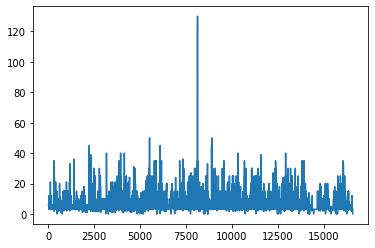

In [11]:
##get coordinates
df_speed['lat'] = df_speed['geometry'].apply(lambda coord: coord.y)
df_speed['lng'] = df_speed['geometry'].apply(lambda coord: coord.x)

## group by location
data_speed = df_speed.groupby(['lat','lng'])[['time_diff']].sum().reset_index()

### plot times
plt.plot(data_speed['time_diff'])
data_speed['time_diff'].describe()

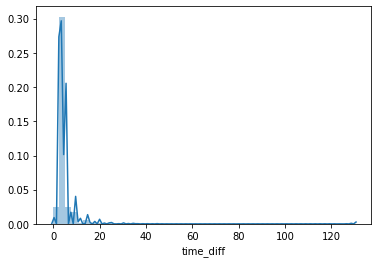

In [12]:
sns.distplot(data_speed['time_diff'])

C:\Anaconda\envs\python3\lib\site-packages\libpysal\weights\weights.py:167: UserWarning: The weights matrix is not fully connected: 
 There are 558 disconnected components.
 There are 92 islands with ids: 571, 993, 1500, 1596, 1696, 2160, 2243, 2244, 2322, 2469, 2570, 2684, 2935, 2937, 3002, 3741, 3804, 4006, 4822, 4831, 5025, 5053, 5110, 5396, 5470, 5535, 5616, 5618, 5725, 5763, 5784, 6003, 6049, 6091, 6179, 6354, 6432, 6614, 6651, 6679, 6706, 6802, 6812, 6875, 6887, 7091, 7562, 7669, 7853, 8240, 8246, 8666, 8677, 8681, 8888, 9266, 9572, 10108, 11247, 11821, 12050, 12251, 12309, 12319, 12320, 12863, 12960, 13482, 13811, 13971, 13976, 14011, 14134, 14147, 14149, 14150, 14153, 14195, 14204, 14235, 14236, 14965, 15195, 15200, 15291, 15335, 15708, 15746, 15770, 16312, 16313, 16443.
  warnings.warn(message)


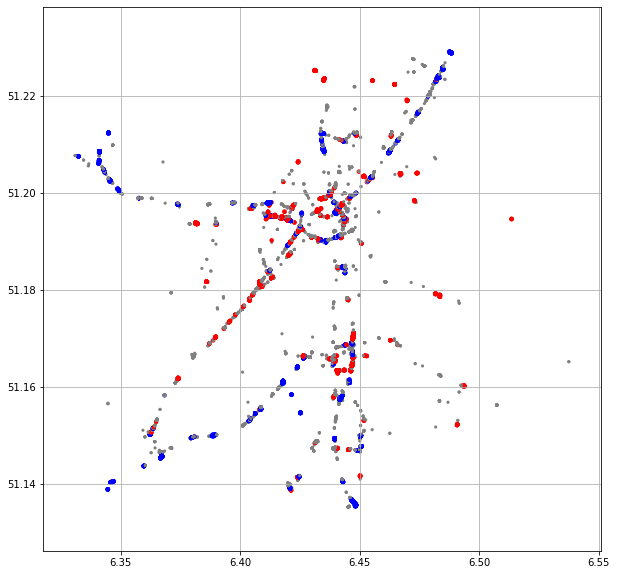

In [13]:
speedGetis = getisOrd(data_speed, 'time_diff', 30)
plot(speedGetis)

In [ ]:
m = folium.Map(tiles = 'Stamen Terrain', zoom_start=12)
map(m, speedGetis, value = 'time_diff', style ='hotspots')
m

In [14]:
len(speedGetis[speedGetis['p_value'] < 0.05])
speedGetis

,lat,lng,time_diff,z_score,p_value
0,51.135224,6.445199,6.0,1.290525,0.098434
1,51.135225,6.445199,6.0,1.290525,0.098434
2,51.135225,6.445177,6.0,1.290525,0.098434
3,51.135225,6.445201,6.0,1.290525,0.098434
4,51.135229,6.445201,6.0,1.290525,0.098434
...,...,...,...,...,...
16573,51.229116,6.487625,3.0,-1.936995,0.026373
16574,51.229116,6.487624,3.0,-1.936995,0.026373
16575,51.229117,6.487624,3.0,-1.936995,0.026373
16576,51.229118,6.487624,3.0,-1.936995,0.026373


In [15]:
zip_codes = gpd.read_file('Data/MC_division.geojson')
getis_speed = gpd.GeoDataFrame(speedGetis, geometry=gpd.points_from_xy(speedGetis.lng, speedGetis.lat), crs='epsg:4326')
track_df_join = gpd.sjoin(zip_codes, getis_speed)
speed_zip = track_df_join.dissolve(by='Nummer', aggfunc='mean')

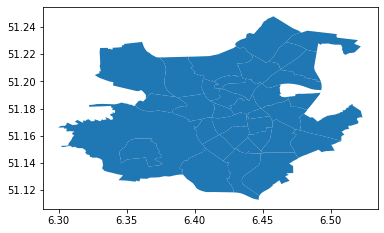

In [86]:
speed_zip.plot()

In [87]:
time_diff = speed_zip['time_diff']
w = pysal.lib.weights.Queen.from_dataframe(speed_zip)
moran_time = esda.Moran_Local(time_diff, w, permutations=9999)
sig = moran_time.p_sim < 0.10
hotspots = moran_time.q==1 * sig
coldspots = moran_time.q==3 * sig

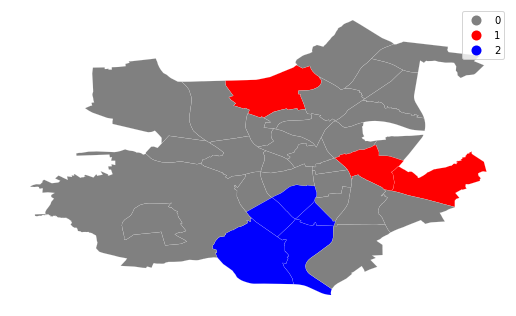

In [88]:
from matplotlib import colors
hcmap = colors.ListedColormap(['grey', 'red','blue'])
hotcold = hotspots*1 + coldspots*2
f, ax = plt.subplots(1, figsize=(9, 9))
speed_zip.assign(cl=hotcold).plot(column='cl', categorical=True, \
        k=2, cmap=hcmap,linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
plt.show()

In [89]:
center_lat= 51.1592265
center_lng = 6.3596619
m = folium.Map(location=[center_lat, center_lng], tiles = 'Stamen Terrain', zoom_start=12)

add_polygon(m,speed_zip, '#ada8a7')
add_polygon(m, speed_zip[hotspots],'#ea6348')
add_polygon(m, speed_zip[coldspots],'#5990ed')
map(m, speedGetis, value ='time_diff', style = 'hotspots')

m

### Analysis with Traffic Lights

In [66]:
traffic_lights = gpd.read_file('Data/Traffic_lights.shp')
traffic_lights.head()

,id,@id,highway,traffic_si,crossing,TMC_cid_58,TMC_cid__1,TMC_cid__2,TMC_cid__3,TMC_cid__4,...,tactile_pa,traffic_ca,ele,maxspeed,side,descriptio,foot,crossing_i,kerb,geometry
0,node/87225547,node/87225547,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.46556 51.21058)
1,node/87225564,node/87225564,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.47429 51.21641)
2,node/87225575,node/87225575,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.47925 51.22051)
3,node/87225834,node/87225834,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.46336 51.21235)
4,node/87225893,node/87225893,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.47456 51.20406)


In [67]:
traffic_lights_proj = traffic_lights.to_crs('EPSG:25832')
traffic_lights_proj['geometry'] = traffic_lights_proj.geometry.buffer(20)

In [69]:
getis_speed = getis_speed[getis_speed['p_value'] < 0.05].to_crs('EPSG:25832')
lights_speed = gpd.sjoin(getis_speed,traffic_lights_proj,op='within').reset_index()
lights_speed.head()

,index,lat,lng,time_diff,z_score,p_value,geometry,index_right,id,@id,...,note,tactile_pa,traffic_ca,ele,maxspeed,side,descriptio,foot,crossing_i,kerb
0,155,51.136063,6.447746,3.0,-1.810887,0.035079,POINT (321446.190 5668053.204),324,node/127442782,node/127442782,...,None,None,None,None,None,None,None,None,None,None
1,160,51.136088,6.447826,3.0,-2.215731,0.013355,POINT (321451.843 5668055.842),324,node/127442782,node/127442782,...,None,None,None,None,None,None,None,None,None,None
2,161,51.136090,6.447826,12.0,-2.552398,0.005349,POINT (321451.863 5668056.011),324,node/127442782,node/127442782,...,None,None,None,None,None,None,None,None,None,None
3,163,51.136091,6.447826,3.0,-2.175010,0.014815,POINT (321451.882 5668056.180),324,node/127442782,node/127442782,...,None,None,None,None,None,None,None,None,None,None
4,303,51.138685,6.421340,21.0,9.206934,0.000000,POINT (319609.345 5668409.214),330,node/4909133140,node/4909133140,...,None,None,None,None,None,None,None,None,None,None


In [95]:
print('total hotspots and coldspots:', len(getis_speed))
print('traffic lights hotspots and coldspots:' + str(len(lights_speed)) +
      ' (Hotspots: ' + str(len(lights_speed[lights_speed['z_score'] > 0])) +
      ' Coldspots: ' + str(len(lights_speed[lights_speed['z_score'] < 0])) + ')')

total hotspots and coldspots: 8424
traffic lights hotspots and coldspots:2952 (Hotspots: 1436 Coldspots: 1516)


In [100]:
print('max hotspots time: ' ,lights_speed[lights_speed['z_score'] > 0]['time_diff'].max())
print('max coldspots time: ' ,lights_speed[lights_speed['z_score'] < 0]['time_diff'].max())

max hotspots time:  45.0
max coldspots time:  25.0


In [90]:
m = folium.Map(location=[center_lat, center_lng], tiles = 'Stamen Terrain', zoom_start=12)

#hotspots not near the signal
getis_speed_wgs = getis_speed.to_crs('EPSG:4326')
getis_speed_wgs.head()
getis_speed_wgs['lat'] = getis_speed_wgs['geometry'].apply(lambda coord: coord.y)
getis_speed_wgs['lng'] = getis_speed_wgs['geometry'].apply(lambda coord: coord.x)
map(m, getis_speed_wgs, style ='non-hotspots', col = '#a2aea6')

#hotspots near the traffic signals
lights_speed_wgs = lights_speed.to_crs('EPSG:4326')
lights_speed_wgs['lat'] = lights_speed_wgs['geometry'].apply(lambda coord: coord.y)
lights_speed_wgs['lng'] = lights_speed_wgs['geometry'].apply(lambda coord: coord.x)
map(m,lights_speed_wgs, value='time_diff', style ='hotspots')
m

### Hotspots For CO2 Emmission

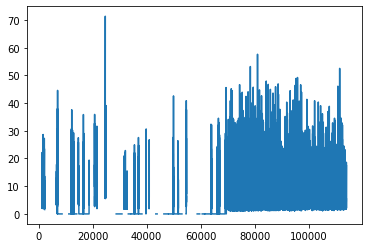

In [25]:
track_df_500['CO2.value'].describe()
track_df_500['CO2.value'].plot()

In [23]:
CO2 = track_df_500.dropna(subset = ['CO2.value'])
len(CO2)

78549

In [24]:
CO2['lat'] = CO2['geometry'].apply(lambda coord: coord.y)
CO2['lng'] = CO2['geometry'].apply(lambda coord: coord.x)
CO2['CO2'] = CO2['CO2.value']
# df_CO2.head()
data_CO2 = CO2.groupby(['lat','lng'])[['CO2']].sum().reset_index()
data_CO2.head()

,lat,lng,CO2
0,51.133700,6.424356,14.160815
1,51.133704,6.424346,1.619428
2,51.133716,6.337975,4.670229
3,51.133719,6.424336,19.541781
4,51.133720,6.424357,17.322643


In [ ]:
getisCO2 = getisOrd(data_CO2, 'CO2', 50)
plot(getisCO2)
to_feather(getisCO2, 'Data/Getis_CO2.feather')
getisCO2 = from_feather('Data/Getis_CO2.feather')

In [ ]:
m = folium.Map(tiles = 'Stamen Terrain', zoom_start=12)
map(m, getisCO2, value = 'CO2', style ='hotspots')
m

In [26]:
spatial_CO2 = gpd.GeoDataFrame(data_CO2, geometry=gpd.points_from_xy(data_CO2.lng, data_CO2.lat), crs='epsg:4326')
track_df_join = gpd.sjoin(zip_codes, spatial_CO2)
CO2_zip = track_df_join.dissolve(by='Nummer', aggfunc='mean')
CO2_value = CO2_zip['CO2']

In [41]:
w = pysal.lib.weights.Queen.from_dataframe(CO2_zip)
moran_time = esda.Moran_Local(CO2_value, w, permutations=9999)
sig = moran_time.p_sim < 0.10
hotspots = moran_time.q==1 * sig
coldspots = moran_time.q==3 * sig

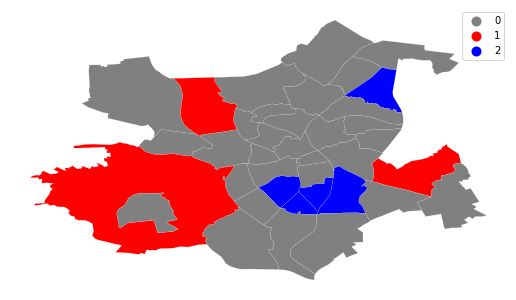

In [42]:
hcmap = colors.ListedColormap(['grey', 'red','blue'])
hotcold = hotspots*1 + coldspots*2
f, ax = plt.subplots(1, figsize=(9, 9))
CO2_zip.assign(cl=hotcold).plot(column='cl', categorical=True, \
        k=2, cmap=hcmap,linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
plt.show()

### Compare CO2 with Speed

In [52]:
speed_CO2_df = track_df_500.dropna(subset= ['CO2.value', 'Speed.value'])
speed_CO2_df['speed_diff'] = speed_CO2_df['Speed.value'] - speed_CO2_df['Speed.value'].shift()
tracks_id = (speed_CO2_df['id'].groupby(speed_CO2_df['track.id']).nth(0)).tolist()
speed_CO2_df['speed_diff'][speed_CO2_df['id'].isin(tracks_id)] = 0

C:\Anaconda\envs\python3\lib\site-packages\seaborn\axisgrid.py:1840: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))
C:\Anaconda\envs\python3\lib\site-packages\seaborn\axisgrid.py:1840: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


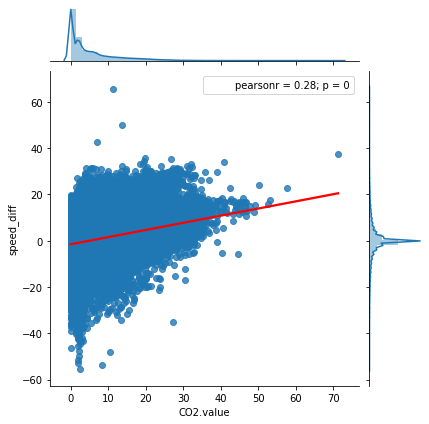

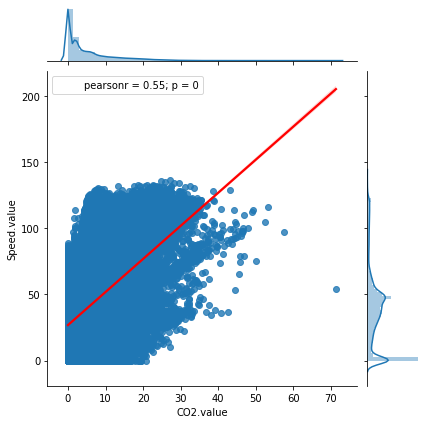

In [65]:
g = sns.jointplot(x="CO2.value", y="speed_diff", data=speed_CO2_df, kind='reg', joint_kws={'line_kws':{'color':'red'}}).annotate(stats.pearsonr)
g = sns.jointplot(x="CO2.value", y="Speed.value", data=speed_CO2_df, kind='reg', joint_kws={'line_kws':{'color':'red'}}).annotate(stats.pearsonr)

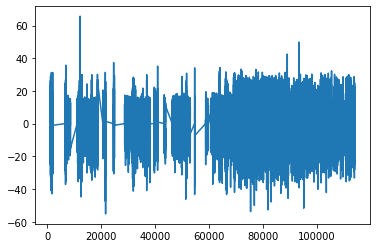

In [59]:
track_df_500['Speed.value'].describe()
track_df_500['Speed.value'].plot()

In [61]:
speed = speed_CO2_df.dropna(subset = ['Speed.value'])
len(speed)
speed['lat'] = speed['geometry'].apply(lambda coord: coord.y)
speed['lng'] = speed['geometry'].apply(lambda coord: coord.x)
speed['speed'] = speed['Speed.value']
# df_speed.head()
data_speed = speed.groupby(['lat','lng'])[['speed']].sum().reset_index()
data_speed.head()

,lat,lng,speed
0,51.133700,6.424356,0.0
1,51.133704,6.424346,0.0
2,51.133716,6.337975,0.0
3,51.133719,6.424336,0.0
4,51.133720,6.424357,0.0


In [33]:
getis_speed_spatial = gpd.GeoDataFrame(data_speed, geometry=gpd.points_from_xy(data_speed.lng, data_speed.lat), crs='epsg:4326')
track_df_join = gpd.sjoin(zip_codes, getis_speed_spatial)
speed_spatial_zip = track_df_join.dissolve(by='Nummer', aggfunc='mean')
speed_value = speed_spatial_zip['speed']

In [39]:
w = pysal.lib.weights.Queen.from_dataframe(speed_spatial_zip)
moran_time = esda.Moran_Local(speed_value , w, permutations=9999)
sig = moran_time.p_sim < 0.10
hotspots = moran_time.q==1 * sig
coldspots = moran_time.q==3 * sig

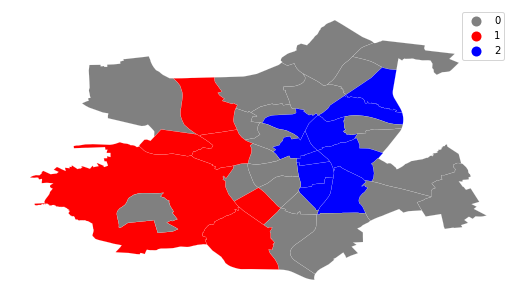

In [40]:
hcmap = colors.ListedColormap(['grey', 'red','blue'])
hotcold = hotspots*1 + coldspots*2
f, ax = plt.subplots(1, figsize=(9, 9))
speed_spatial_zip.assign(cl=hotcold).plot(column='cl', categorical=True, \
        k=2, cmap=hcmap,linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
plt.show()

### Inflow / OutFlow

In [104]:
##identify first record in each track and adding a default value of 0
track_df_500.sort_values('id').groupby('track.id').apply(lambda x: x.tail(1))

,,level_0,index,id,time,geometry,GPS Bearing.value,GPS Bearing.unit,Intake Temperature.value,Intake Temperature.unit,MAF.value,...,Throttle Position.value,Throttle Position.unit,track.appVersion,track.touVersion,O2 Lambda Voltage.value,O2 Lambda Voltage.unit,O2 Lambda Voltage ER.value,O2 Lambda Voltage ER.unit,time_datetime,time_diff
track.id,,,,,,,,,,,,,,,,,,,,,,
5a1fed58268d1b08cdfb52a6,114044,114044,154167,5a1fed58268d1b08cdfb537b,2017-11-30T07:57:14,POINT (6.45604 51.16605),92.594054,deg,12.000000,c,NaN,...,16.000000,%,"Version 0.22.5 (34), 16.06.16 14:06",2013-10-01,NaN,None,NaN,None,2017-11-30 07:57:14,5.0
5a1fed5a268d1b08cdfb5526,113833,113833,153956,5a1fed5a268d1b08cdfb557e,2017-11-30T10:20:39,POINT (6.39562 51.17361),231.612209,deg,21.000000,c,NaN,...,12.000000,%,None,None,NaN,None,NaN,None,2017-11-30 10:20:39,5.0
5a207b60268d1b08cdfb8710,113747,113747,153870,5a207b60268d1b08cdfb8790,2017-11-30T12:55:48,POINT (6.47915 51.22035),34.769300,deg,26.000000,c,NaN,...,66.867521,%,None,None,NaN,None,NaN,None,2017-11-30 12:55:48,5.0
5a2e3c0c268d1b08cd0eaed9,113097,113097,153083,5a2e3c0c268d1b08cd0eaf64,2017-11-30T17:15:21,POINT (6.44871 51.20370),223.223786,deg,12.000000,c,11.807534,...,22.785297,%,None,None,3.347782,V,1.004093,ratio,2017-11-30 17:15:21,5.0
5a2e3c21268d1b08cd0eb078,112624,112624,152210,5a2e3c21268d1b08cd0eb10d,2017-12-01T05:40:03,POINT (6.42425 51.13376),188.596988,deg,6.000000,c,14.399223,...,23.792923,%,None,None,3.322692,V,0.996982,ratio,2017-12-01 05:40:03,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5b45976444ea850910a18b7f,973,973,973,5b45976444ea850910a18c15,2018-07-10T14:23:09,POINT (6.37963 51.15162),347.732414,deg,22.000000,c,16.544907,...,NaN,None,None,None,NaN,None,NaN,None,2018-07-10 14:23:09,5.0
5b45979144ea850910a18d41,2033,2033,2033,5b45979144ea850910a18dbc,2018-07-09T09:14:19,POINT (6.44383 51.18507),186.654696,deg,30.000000,c,8.261532,...,NaN,None,"Version 0.22.5 (34), 16.06.16 14:06",2013-10-01,NaN,None,NaN,None,2018-07-09 09:14:19,5.0
5b46294d44ea850910a1c0cb,358,358,358,5b46294d44ea850910a1c121,2018-07-11T05:53:43,POINT (6.41382 51.20348),297.805657,deg,22.000000,c,43.236325,...,NaN,None,None,None,NaN,None,NaN,None,2018-07-11 05:53:43,5.0
